In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import anndata as ad
import scanpy as sc

from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from umap import UMAP

from scroutines.miscu import is_in_polygon
from scroutines import powerplots

import importlib
importlib.reload(powerplots)
import utils_merfish # current dir
importlib.reload(utils_merfish)

<module 'utils_merfish' from '/u/project/zipursky/f7xiesnm/v1-bb/v1/myvisctx/analysis_merfish/utils_merfish.py'>

In [2]:
outdir = "/u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/results_merfish/plots_230717"
outdatadir = "/u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/results_merfish"
# !mkdir -p $outdir
!ls /data/qlyu/v1/results_merfish

ls: cannot access /data/qlyu/v1/results_merfish: No such file or directory


In [4]:
adata_a0 = ad.read('/u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/results_merfish/ant_reg0_ctxglut_230623.h5ad')
adata_a1 = ad.read('/u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/results_merfish/ant_reg1_ctxglut_230717.h5ad')
adata_p0 = ad.read('/u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/results_merfish/pos_reg0_ctxglut_230719.h5ad')
adata_p1 = ad.read('/u/home/f/f7xiesnm/project-zipursky/v1-bb/v1/results_merfish/pos_reg1_ctxglut_230719.h5ad')

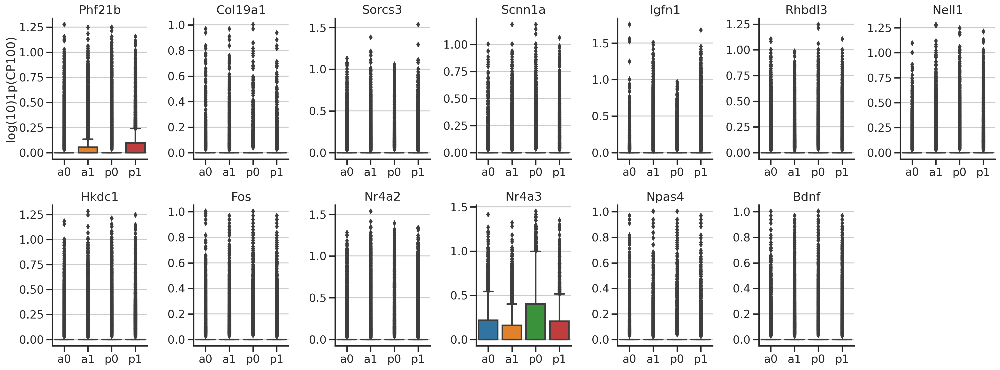

In [5]:
geneset1 = [
    'Phf21b',
    'Col19a1',
    'Sorcs3',
    'Scnn1a', 'Igfn1',
    'Rhbdl3', 'Nell1', 'Hkdc1',
    'Fos', 'Nr4a2', 'Nr4a3', 'Npas4', 'Bdnf',
]
n = len(geneset1)
nx = 7
ny = int((n+nx-1)/nx)

fig, axs = plt.subplots(ny,nx, figsize=(nx*3,ny*4))
axs.flat[0].set_ylabel('log(10)1p(CP100)')

for i, (gn, ax) in enumerate(zip(geneset1, axs.flat)):
    g_a0 = np.log10(np.ravel(1+adata_a0[:,gn].layers['norm']))
    g_a1 = np.log10(np.ravel(1+adata_a1[:,gn].layers['norm']))
    g_p0 = np.log10(np.ravel(1+adata_p0[:,gn].layers['norm']))
    g_p1 = np.log10(np.ravel(1+adata_p1[:,gn].layers['norm']))
    
    sns.boxplot(pd.DataFrame([g_a0, g_a1, g_p0, g_p1], 
                       index=['a0', 'a1', 'p0', 'p1']).T, 
                ax=ax)
    sns.despine(ax=ax)
    ax.set_title(gn)
    
for ax in axs.flat[i+1:]:
    ax.axis('off')
    
fig.tight_layout()
plt.show()

In [8]:
def plot_fish(gn, vmax_p=98):
    """all 4 slices consistently
    """
    x_a0, y_a0, g_a0 = utils_merfish.get_xyg(adata_a0, gn, 'norm')
    x_a1, y_a1, g_a1 = utils_merfish.get_xyg(adata_a1, gn, 'norm')
    x_p0, y_p0, g_p0 = utils_merfish.get_xyg(adata_p0, gn, 'norm')
    x_p1, y_p1, g_p1 = utils_merfish.get_xyg(adata_p1, gn, 'norm')

    g = np.hstack([g_a0, g_a1, g_p0, g_p1])
    vmax = np.percentile(g, vmax_p)
    flag = ''
    if vmax < 1e-7: 
        vmax = 1 # non-expressed
        flag = '**not expressed**'
    title = f"{gn} (max {vmax:.2g} at {vmax_p:.2g} pctl) {flag}"

    fig, axs = plt.subplots(2,2,figsize=(2*6,2*4))
    fig.suptitle(title, fontsize=15)
    ax = axs[0,0]
    utils_merfish.st_scatter_ax(fig, ax, x_a0, y_a0, gexp=g_a0, s=2, unit_norm=True, title='P14 ant', vmax=vmax)
    ax = axs[0,1]
    utils_merfish.st_scatter_ax(fig, ax, x_a1, y_a1, gexp=g_a1, s=2, unit_norm=True, title='P28 ant', vmax=vmax)
    ax = axs[1,0]
    utils_merfish.st_scatter_ax(fig, ax, x_p0, y_p0, gexp=g_p0, s=2, unit_norm=True, title='P14 pos', vmax=vmax)
    ax = axs[1,1]
    utils_merfish.st_scatter_ax(fig, ax, x_p1, y_p1, gexp=g_p1, s=2, unit_norm=True, title='P28 pos', vmax=vmax)
    fig.tight_layout()
    plt.show()
    
def plot_fish_gmean(gns, vmax_p=98, vmin_p=2, title='', cmap='coolwarm'):
    """all 4 slices consistently
    """
    x_a0, y_a0, g_a0 = utils_merfish.get_xygmean(adata_a0, gns, 'norm')
    x_a1, y_a1, g_a1 = utils_merfish.get_xygmean(adata_a1, gns, 'norm')
    x_p0, y_p0, g_p0 = utils_merfish.get_xygmean(adata_p0, gns, 'norm')
    x_p1, y_p1, g_p1 = utils_merfish.get_xygmean(adata_p1, gns, 'norm')

    g = np.hstack([g_a0, g_a1, g_p0, g_p1])
    vmax = np.percentile(g, vmax_p)
    vmin = np.percentile(g, vmin_p)
    title = title + f" (n={len(gns)})"

    fig, axs = plt.subplots(2,2,figsize=(2*6,2*4))
    fig.suptitle(title, fontsize=15)
    ax = axs[0,0]
    utils_merfish.st_scatter_ax(fig, ax, x_a0, y_a0, gexp=g_a0, s=2, title='P14 ant', vmin=vmin, vmax=vmax, cmap=cmap)
    ax = axs[0,1]
    utils_merfish.st_scatter_ax(fig, ax, x_a1, y_a1, gexp=g_a1, s=2, title='P28 ant', vmin=vmin, vmax=vmax, cmap=cmap)
    ax = axs[1,0]
    utils_merfish.st_scatter_ax(fig, ax, x_p0, y_p0, gexp=g_p0, s=2, title='P14 pos', vmin=vmin, vmax=vmax, cmap=cmap)
    ax = axs[1,1]
    utils_merfish.st_scatter_ax(fig, ax, x_p1, y_p1, gexp=g_p1, s=2, title='P28 pos', vmin=vmin, vmax=vmax, cmap=cmap)
    fig.tight_layout()
    plt.show()

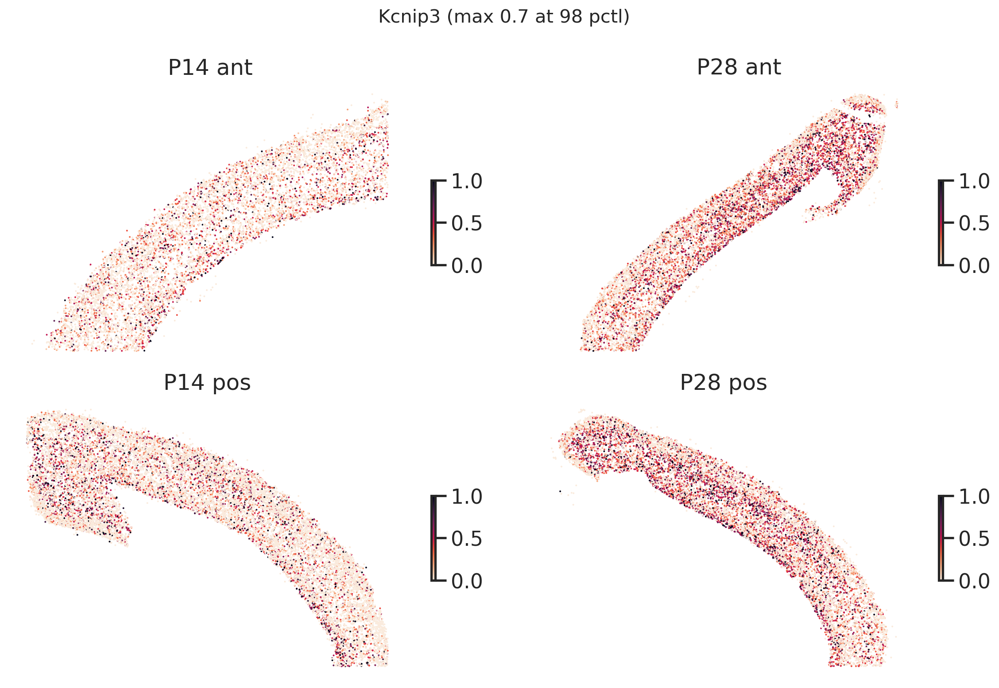

In [9]:
gn = 'Kcnip3'
plot_fish(gn, vmax_p=98)

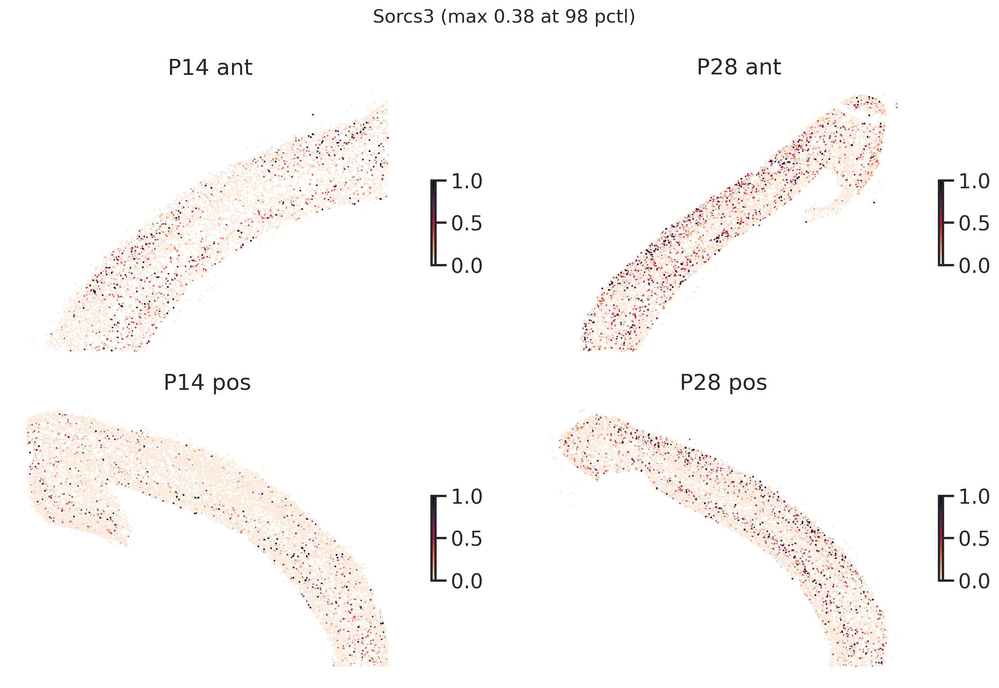

In [10]:
gn = 'Sorcs3'
plot_fish(gn, vmax_p=98)

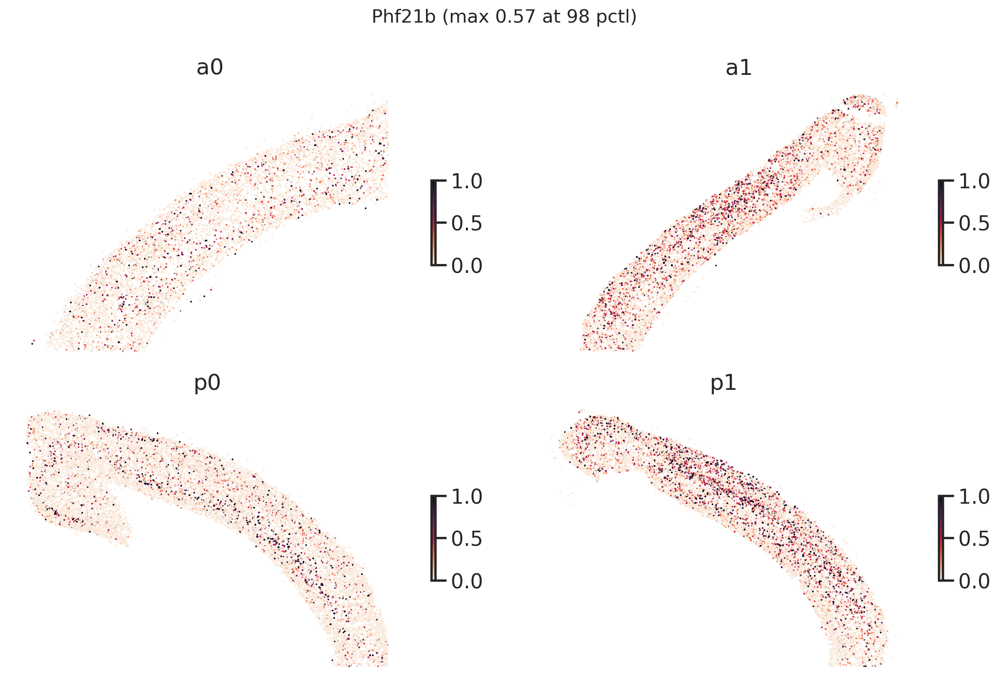

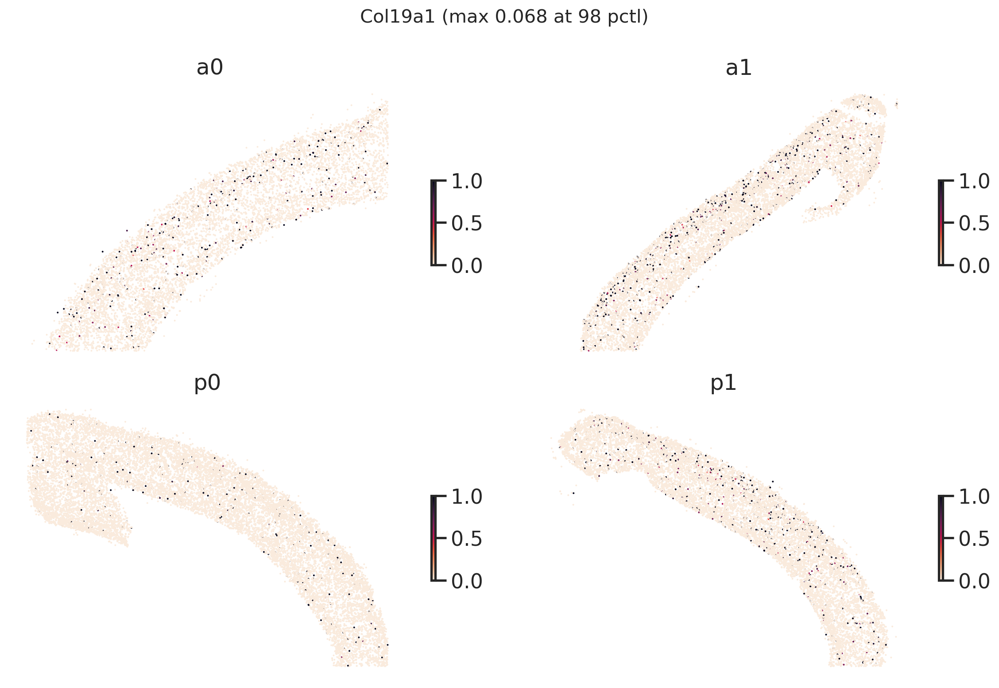

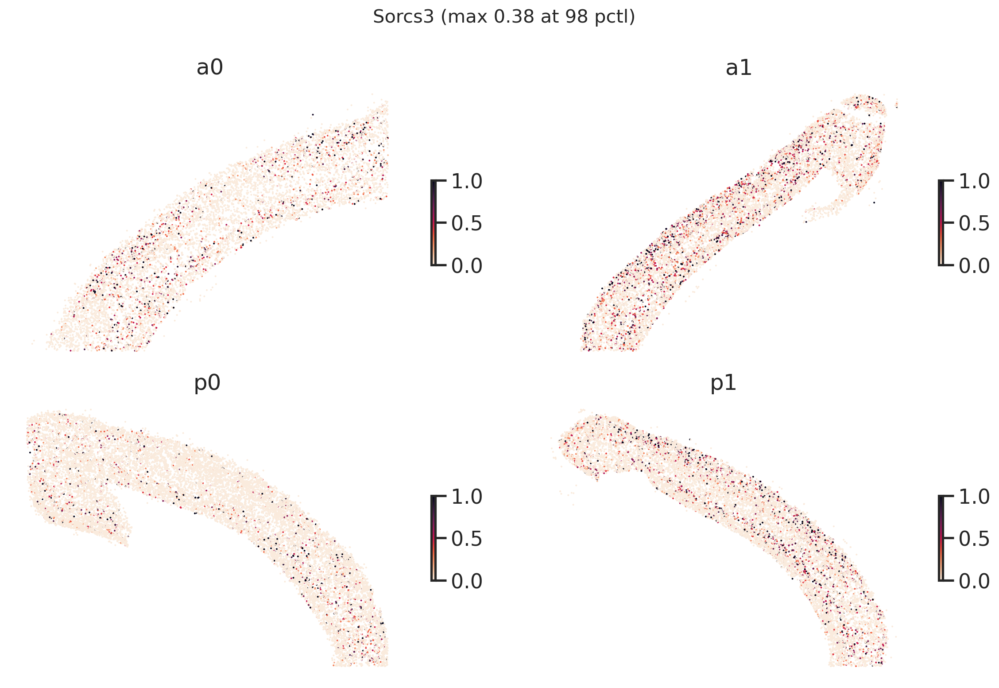

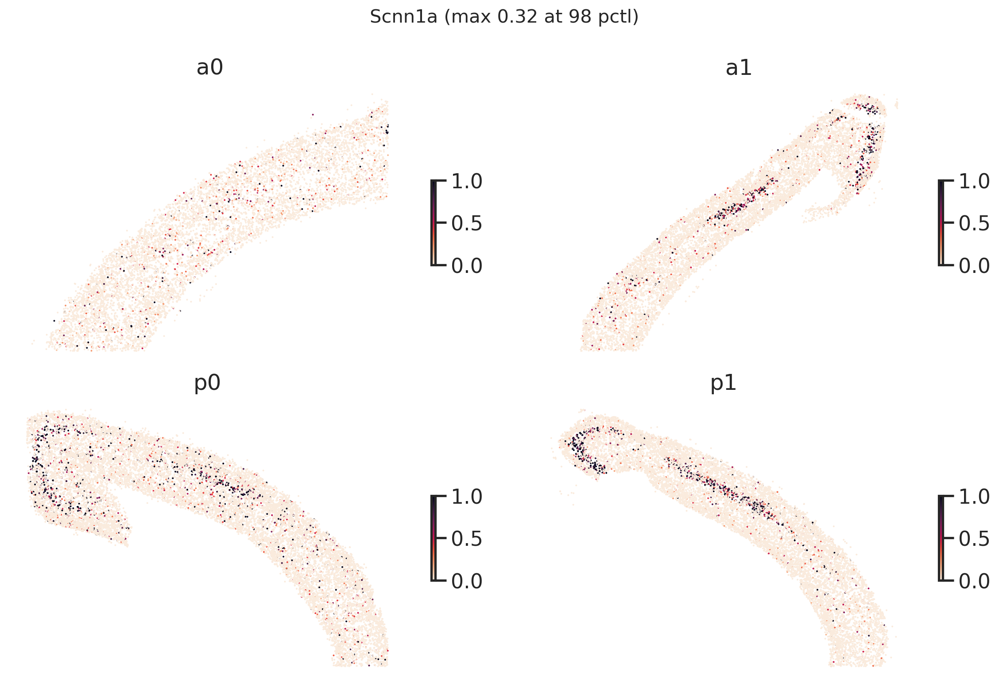

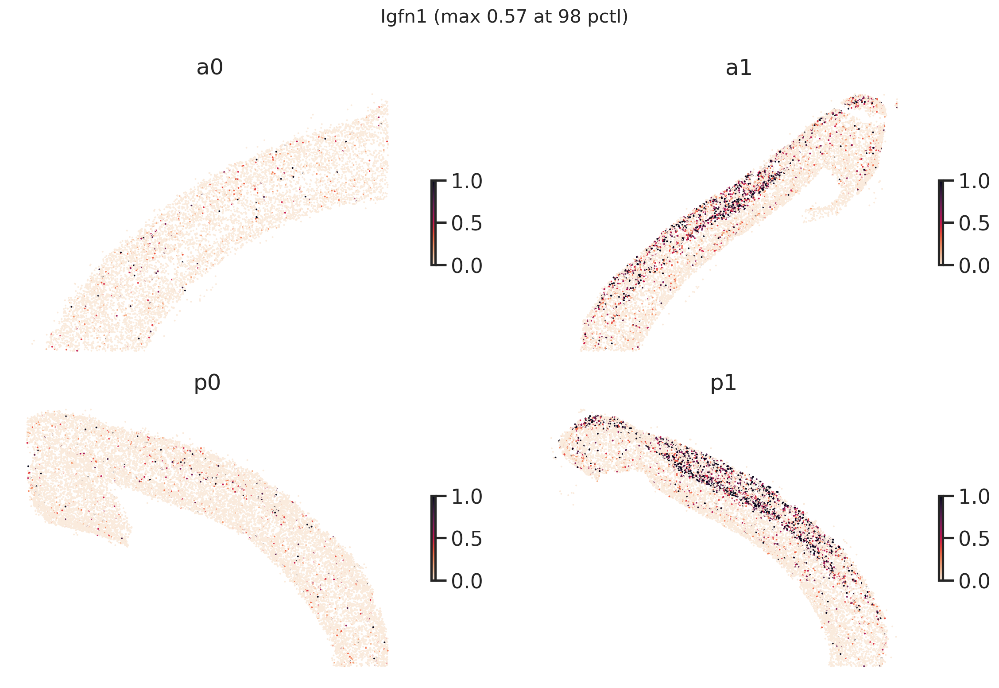

...

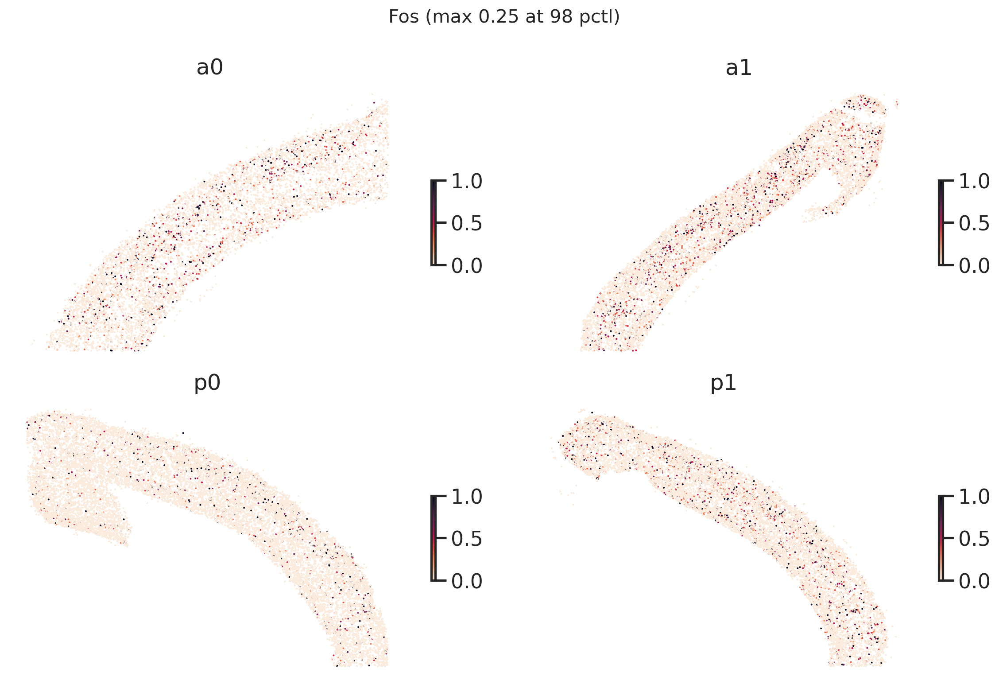

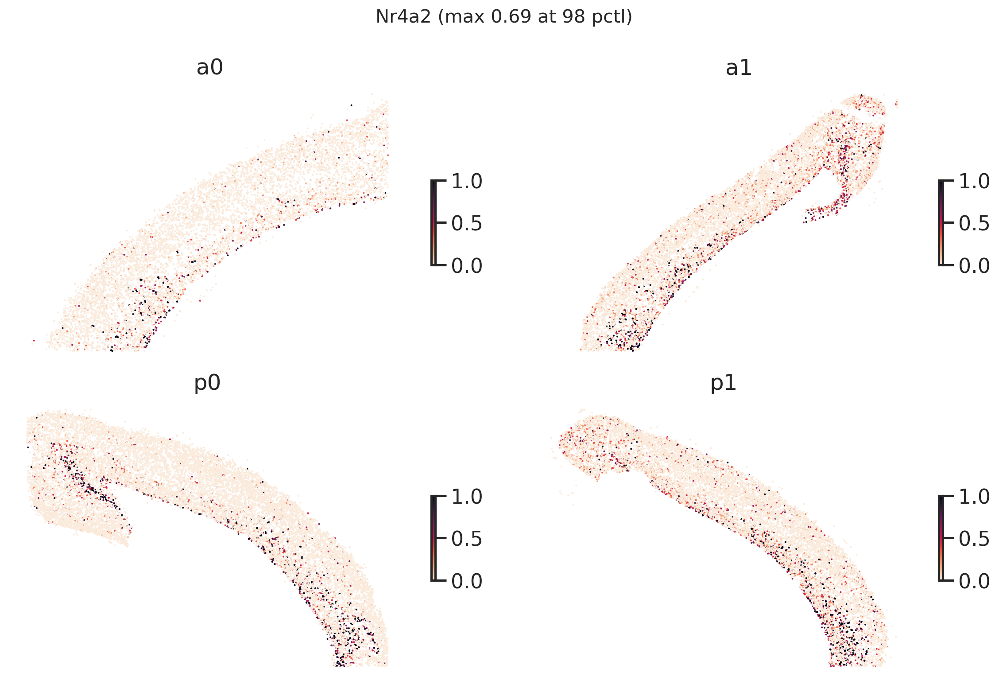

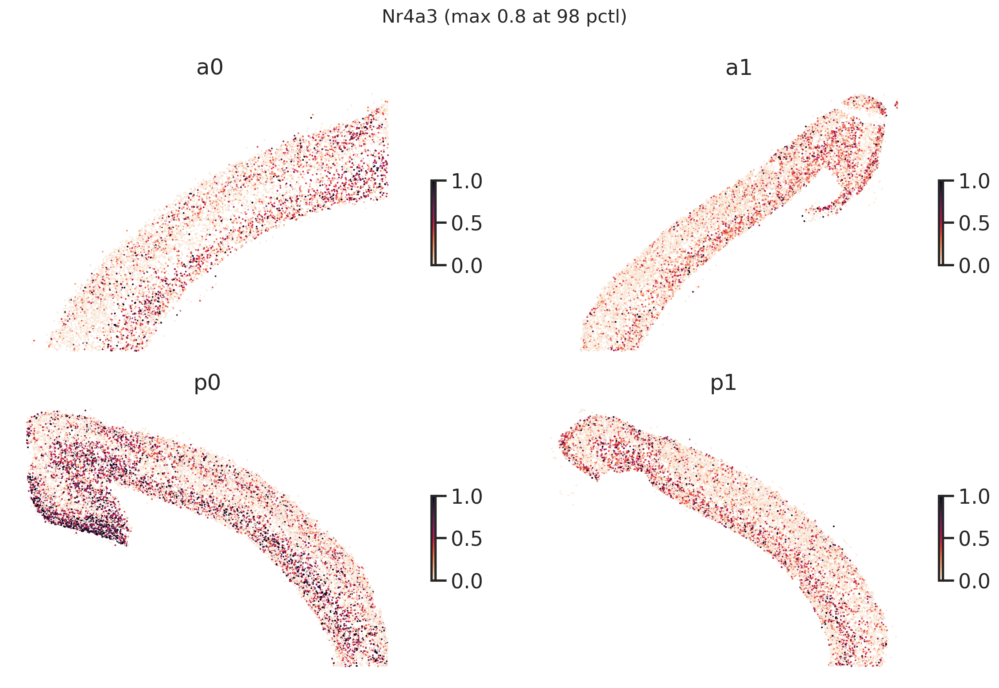

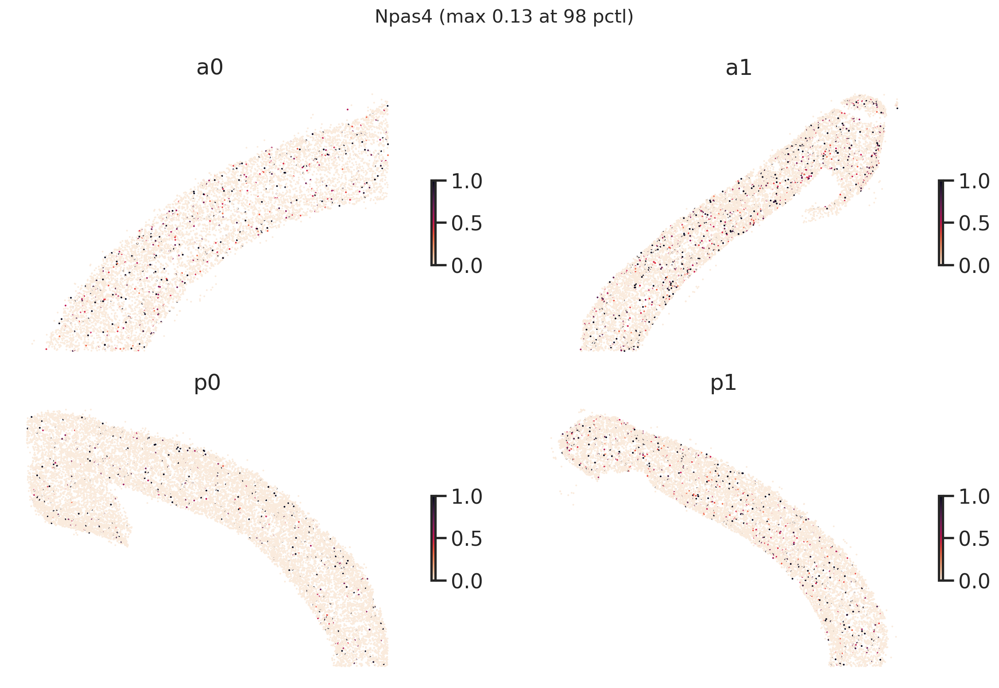

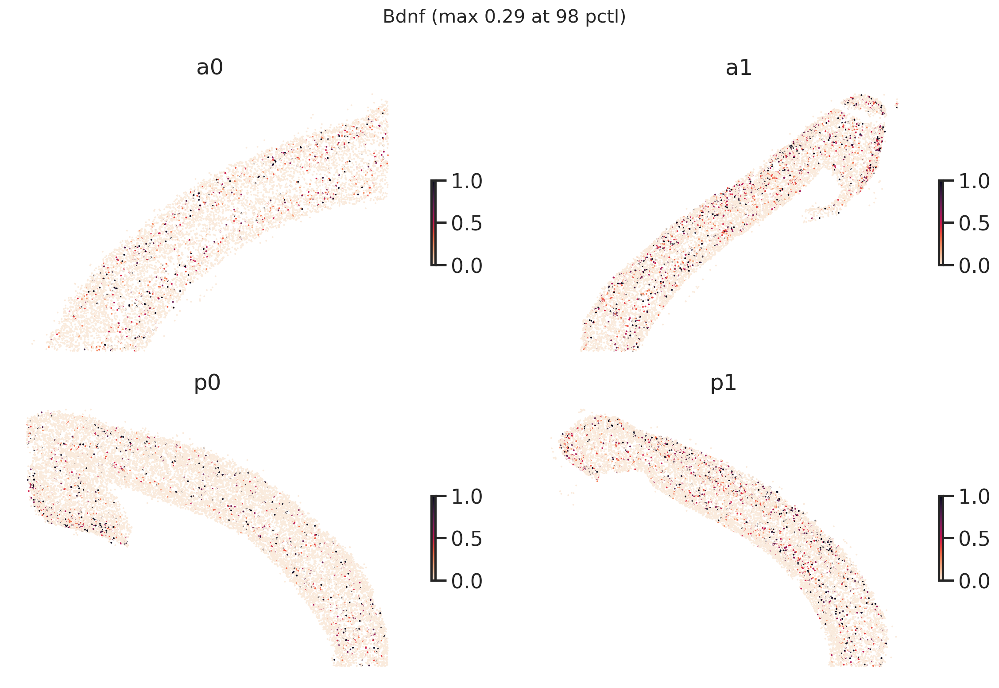

In [7]:
for gn in geneset1:
    plot_fish(gn, vmax_p=98)

# all ABC genes in order

In [8]:
f = '/data/qlyu/v1/results/MERFISH_gene_panel_Version1_March9.csv'
df = pd.read_csv(f)
f = '/data/qlyu/v1/results/gene_ptime_P28_L23_Mar27.tsv'
df2 = pd.read_csv(f).sort_values('gene_ptime')
df = pd.merge(df, df2, left_on='gene_name_data', right_on='gene').sort_values('gene_ptime')
genes_abco = df['gene_name_vizgen'].values
genes_abco.shape

(170,)

In [9]:
agenes = df[df['P17on_x']=='A']['gene_name_vizgen'].values
bgenes = df[df['P17on_x']=='B']['gene_name_vizgen'].values
cgenes = df[df['P17on_x']=='C']['gene_name_vizgen'].values
len(agenes), agenes, len(bgenes), bgenes, len(cgenes), cgenes

(64,
 array(['Met', '6530403H02Rik', 'Rhbdl3', 'Adamts2', 'Cdh13', 'Col23a1',
        'Vwc2l', 'Syt10', 'Kcnn3', 'Arhgef28', 'Pcdh19', 'Pakap', 'Ikzf2',
        'Nckap5', 'Dpyd', 'Gpc5', 'Slc6a7', 'Igsf11', 'Glis3', 'Ttc28',
        'Tenm1', 'Syt17', 'Robo1', 'Sema6a', 'Otof', 'Eda', 'Plxna1',
        'Tox3', 'Itga8', 'Kcnk13', 'Wnt4', 'Sdk2', 'Pdzrn4', 'Plxnd1',
        'Ryr3', 'Necab1', 'Camk2d', 'Iqgap2', 'Pdgfc', 'Gabrg3', 'Dscaml1',
        'Reln', 'Npas3', 'Cntn5', 'Rfx3', 'Grm1', 'Kirrel3', 'Nfib',
        'Fkbp5', 'Zfp608', 'Meis2', 'Mdga1', 'Tiam1', 'Grb14', 'Nkain3',
        'Epha6', 'Cacna1h', 'Pde1a', 'Nr3c2', 'Matn2', 'Tmem150c',
        'Adamts17', 'Ldb2', 'Egfem1'], dtype=object),
 35,
 array(['Grm8', 'Galnt17', 'Epha3', 'Rgs8', 'Sox5', 'Zfp804b', 'Tmeff1',
        'Fstl5', 'Cdh4', 'Kcnip3', 'Myh9', 'Sh3pxd2b', 'Klhl1', 'Trpc6',
        'Sema4a', 'Tafa1', 'Sertm1', 'Nrp1', 'Col26a1', 'Mas1', 'Igfn1',
        'Npas4', 'Scg3', 'Nptx2', 'Bdnf', 'Phf21b', 'Nell1', 'Baz1a',
 

# Merge A,B,C

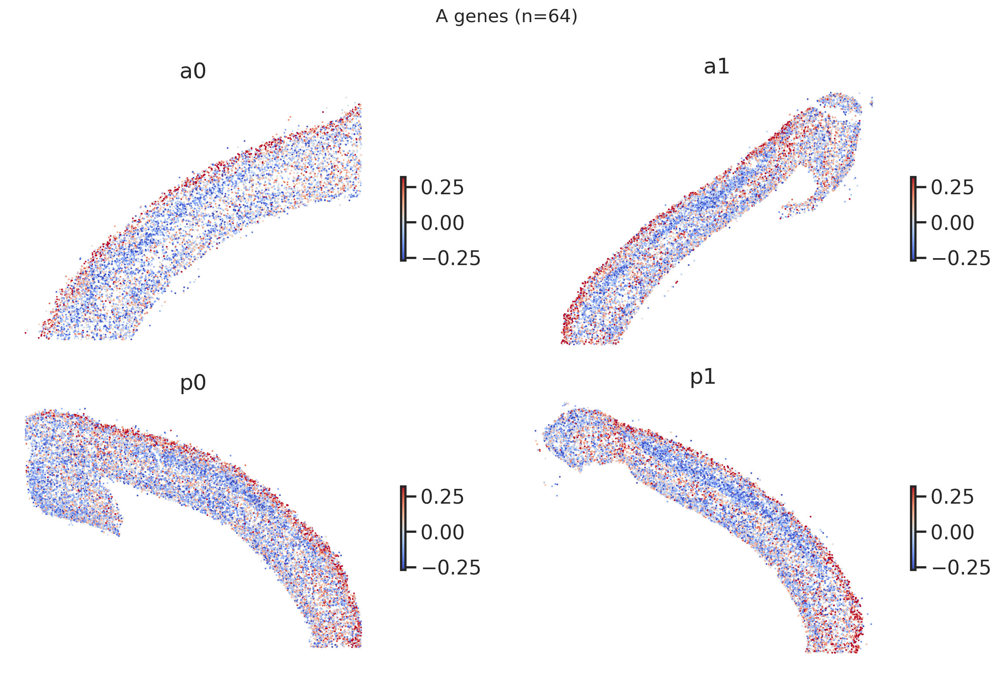

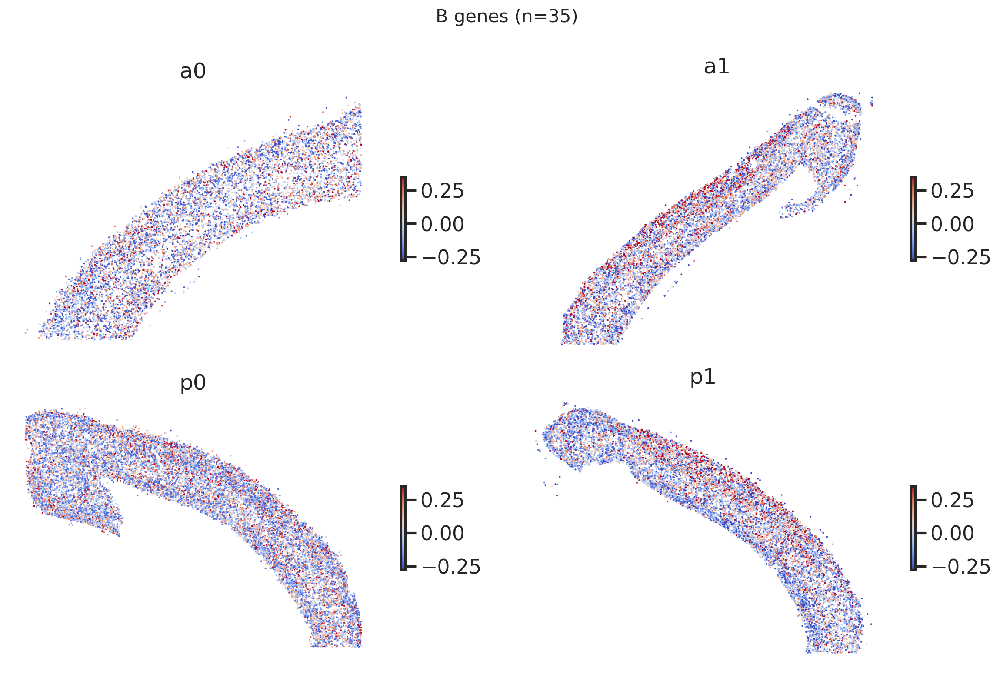

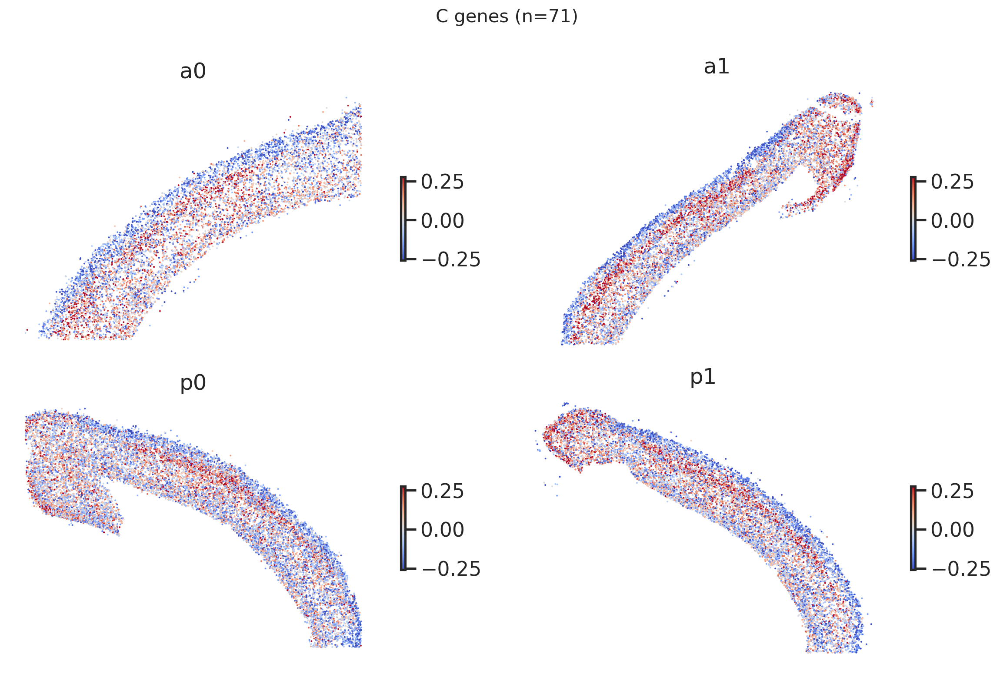

In [10]:
plot_fish_gmean(agenes, title='A genes', vmax_p=95, vmin_p=5, cmap='coolwarm')
plot_fish_gmean(bgenes, title='B genes', vmax_p=95, vmin_p=5, cmap='coolwarm')
plot_fish_gmean(cgenes, title='C genes', vmax_p=95, vmin_p=5, cmap='coolwarm')

# Cdh genes

In [11]:
cdh_genes = np.sort([g for g in adata.var.index.values if g.startswith('Cdh')])
cdh_genes

NameError: name 'adata' is not defined

In [ ]:
plot_fish('Cdh9', vmax_p=98)

In [ ]:
for gn in cdh_genes: 
    plot_fish(gn, vmax_p=98)